#### Import Modules

In [120]:
import pandas as pd
from sklearn import linear_model
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt

#### Initialize Data File

In [121]:
df = pd.read_csv("data.csv")

#### Display Basic Info

In [122]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [123]:
df.tail()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN
568,92751,B,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,...,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039,NaN


In [124]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

#### Daa Cleaning

In [125]:
#Check for null values
#Check for null values in the DataFrame
null_values = df.isnull().sum()

# Display the columns with null values (if any) along with their counts
print("Columns with Null Values:")
print(null_values[null_values > 0])

#Change Y-label(diagnosis) from object to integers where M = 0 and B = 1 

df['diagnosis'] = df['diagnosis'].replace({'M' : 0, 'B' : 1})


Columns with Null Values:
Unnamed: 32    569
dtype: int64


In [126]:
#Descriptive statistics
newdf = df.drop(columns=['id', 'Unnamed: 32'])
newdf.describe()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.627417,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,1.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [127]:
#split data set into training and testing

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [128]:
clf2 = linear_model.LogisticRegression(random_state=0)
clf2.fit(X_train, y_train)

/opt/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression(random_state=0)

In [129]:
yhat2 = clf2.predict(X_test)
print(yhat2)

[1 0 0 1 1 0 0 0 1 1 1 0 1 0 1 0 1 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 0
 1 0 1 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 0 0 1 0
 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 1 0 1 1 0
 1 0 0 1 0 1 1 1 0 1 1 1 0 1 0 0 1 1 0 0 0 1 1 1 0 1 1 1 0 1 0 1 1 0 1 0 0
 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 0 1]


In [130]:

sns.pairplot(newdf, hue='diagnosis')
plt.title('Pairplot of Features')
plt.savefig('pairplot.png')  # Save the plot as an image file
plt.show()


/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed

In [131]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Instantiate the SVM model
svm_model = SVC(kernel='linear', random_state=0)  # Linear kernel for simplicity, adjust as needed

# Train the SVM model on the training data
svm_model.fit(X_train, y_train)

# Predict the labels for the test set
y_pred = svm_model.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Print classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

# Print confusion matrix
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))


Accuracy: 0.9649122807017544
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.94      0.95        63
           1       0.96      0.98      0.97       108

    accuracy                           0.96       171
   macro avg       0.97      0.96      0.96       171
weighted avg       0.96      0.96      0.96       171

Confusion Matrix:
[[ 59   4]
 [  2 106]]


In [132]:
# Assuming svm_model is a trained linear SVM model
coefficients = svm_model.coef_[0]  # Get the coefficients
feature_names = x.columns  # Get the names of the features

# Combine coefficients with feature names
feature_importance = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

# Sort feature importances by absolute coefficient values
feature_importance['Abs_Coefficient'] = abs(feature_importance['Coefficient'])
feature_importance = feature_importance.sort_values(by='Abs_Coefficient', ascending=False)

# Print feature importances
print("Feature Importances:")
print(feature_importance)


Feature Importances:
                    Feature  Coefficient  Abs_Coefficient
11               texture_se     1.803553         1.803553
26          concavity_worst    -1.488906         1.488906
28           symmetry_worst    -1.247490         1.247490
0               radius_mean     1.184591         1.184591
25        compactness_worst    -0.811785         0.811785
6            concavity_mean    -0.609220         0.609220
27     concave points_worst    -0.578521         0.578521
24         smoothness_worst    -0.405825         0.405825
12             perimeter_se     0.392313         0.392313
20             radius_worst    -0.383820         0.383820
21            texture_worst    -0.376288         0.376288
7       concave points_mean    -0.370822         0.370822
8             symmetry_mean    -0.368946         0.368946
5          compactness_mean    -0.273003         0.273003
2            perimeter_mean    -0.253328         0.253328
4           smoothness_mean    -0.206672         0.

In [133]:
pip install shap

Note: you may need to restart the kernel to use updated packages.


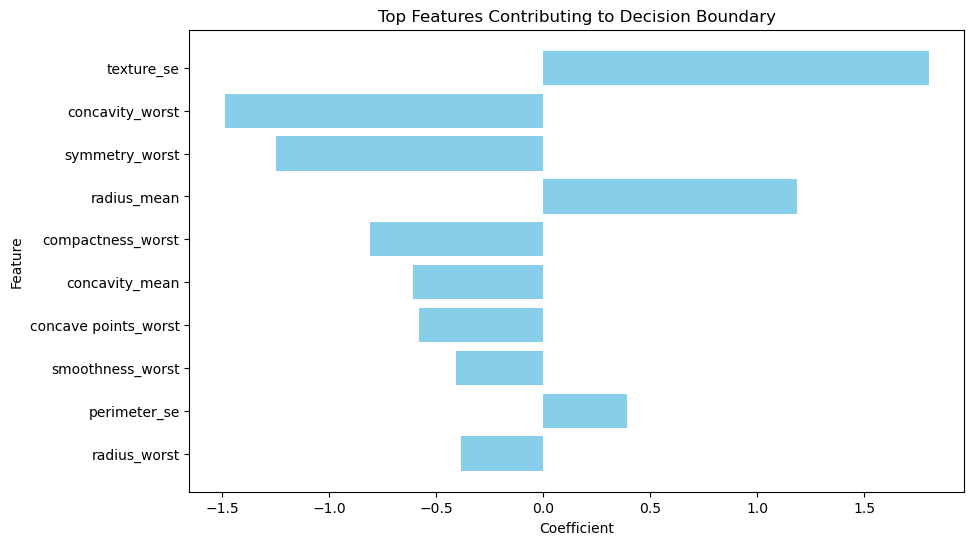

In [134]:

# Assuming feature_importance DataFrame contains feature names and coefficients
top_features = feature_importance.head(10)  # Select top N features (adjust as needed)

# Plot feature importances
plt.figure(figsize=(10, 6))
plt.barh(top_features['Feature'], top_features['Coefficient'], color='skyblue')
plt.xlabel('Coefficient')
plt.ylabel('Feature')
plt.title('Top Features Contributing to Decision Boundary')
plt.gca().invert_yaxis()  # Invert y-axis to show most important features at the top
plt.show()


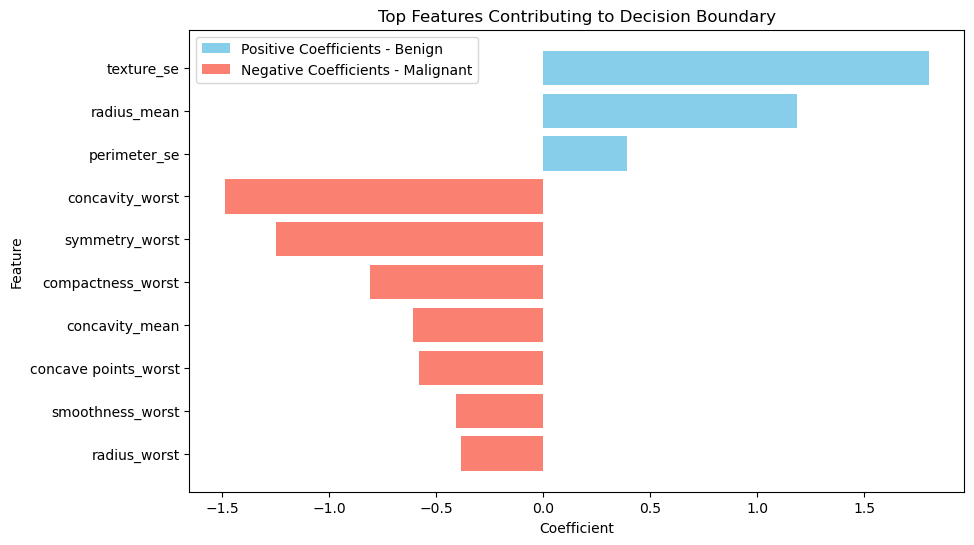

In [135]:
# Assuming feature_importance DataFrame contains feature names and coefficients
top_features = feature_importance.head(10)  # Select top N features (adjust as needed)

# Split positive and negative coefficients into separate DataFrames
positive_features = top_features[top_features['Coefficient'] > 0]
negative_features = top_features[top_features['Coefficient'] < 0]

# Plot feature importances
plt.figure(figsize=(10, 6))
plt.barh(positive_features['Feature'], positive_features['Coefficient'], color='skyblue', label='Positive Coefficients - Benign')
plt.barh(negative_features['Feature'], negative_features['Coefficient'], color='salmon', label='Negative Coefficients - Malignant')
plt.xlabel('Coefficient')
plt.ylabel('Feature')
plt.title('Top Features Contributing to Decision Boundary')
plt.gca().invert_yaxis()  # Invert y-axis to show most important features at the top
plt.legend()
plt.show()


In [136]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC

# Select the top features based on their importance values
top_features = [
    'texture_se', 'concavity_worst', 'symmetry_worst', 'radius_mean', 'compactness_worst',
    'concavity_mean', 'smoothness_worst', 'perimeter_se', 'radius_worst'
]

# Select only the top features from the original dataset
X_selected = x[top_features]

# Split the dataset into training and testing sets
X_train, X_test, Y_train, Y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Define and train the SVM model
svm_model = SVC(kernel='linear', random_state=0)
svm_model.fit(X_train, Y_train)

# Evaluate the model on the test set
accuracy = svm_model.score(X_test, Y_test)
print("Accuracy:", accuracy)


Accuracy: 0.9736842105263158


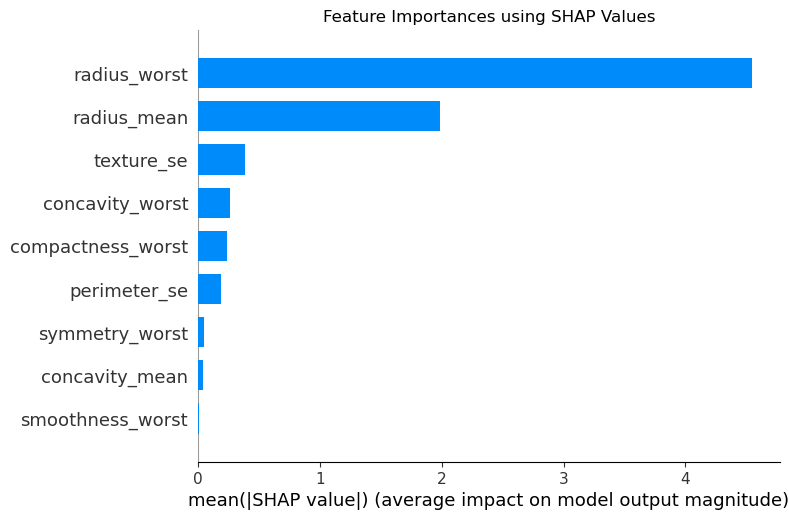

In [137]:
import shap
import matplotlib.pyplot as plt

# Assuming svm_model is a trained SVM model
explainer = shap.Explainer(svm_model, X_train)
shap_values = explainer(X_test)

# Summary plot
shap.summary_plot(shap_values, X_test, plot_type="bar", show=False)
plt.title('Feature Importances using SHAP Values')
plt.show()


In [138]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC

# Define the SVM model
svm_model = SVC()

# Define the hyperparameters to search over
param_grid = {
    'C': [0.1, 1, 10, 100],              # Regularization parameter
    'kernel': ['linear', 'rbf', 'poly'],  # Kernel type
    'gamma': ['scale', 'auto']            # Kernel coefficient for 'rbf' and 'poly'
}

# Perform grid search with cross-validation
grid_search = GridSearchCV(svm_model, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, Y_train)

# Get the best model from grid search
best_svm_model = grid_search.best_estimator_

# Print the best hyperparameters found
print("Best Hyperparameters:", grid_search.best_params_)

# Evaluate the best model on the test set
accuracy = best_svm_model.score(X_test, Y_test)
print("Accuracy on Test Set:", accuracy)


Best Hyperparameters: {'C': 0.1, 'gamma': 'auto', 'kernel': 'poly'}
Accuracy on Test Set: 0.9736842105263158


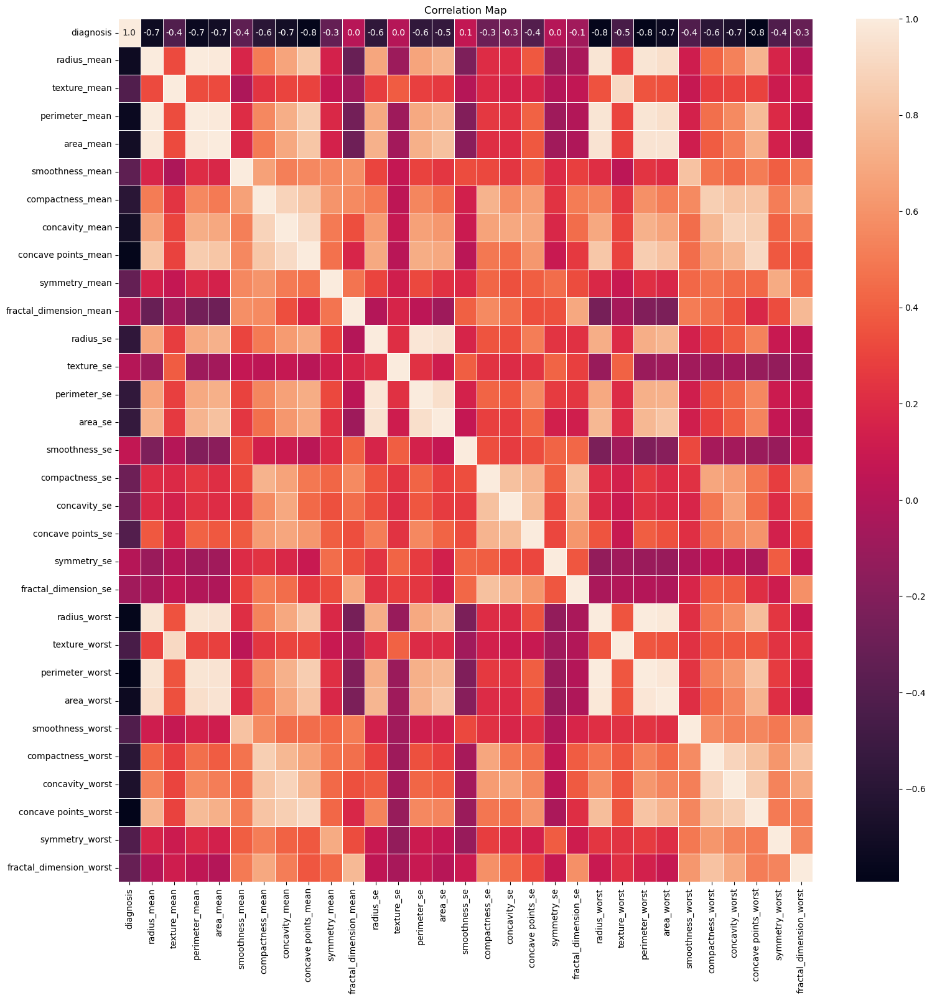

In [110]:
#correlation map
f,ax=plt.subplots(figsize = (18,18))
sns.heatmap(newdf.corr(),annot= True,linewidths=0.5,fmt = ".1f",ax=ax)
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Correlation Map')
plt.show()

/opt/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:260: FutureWarning:

Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior



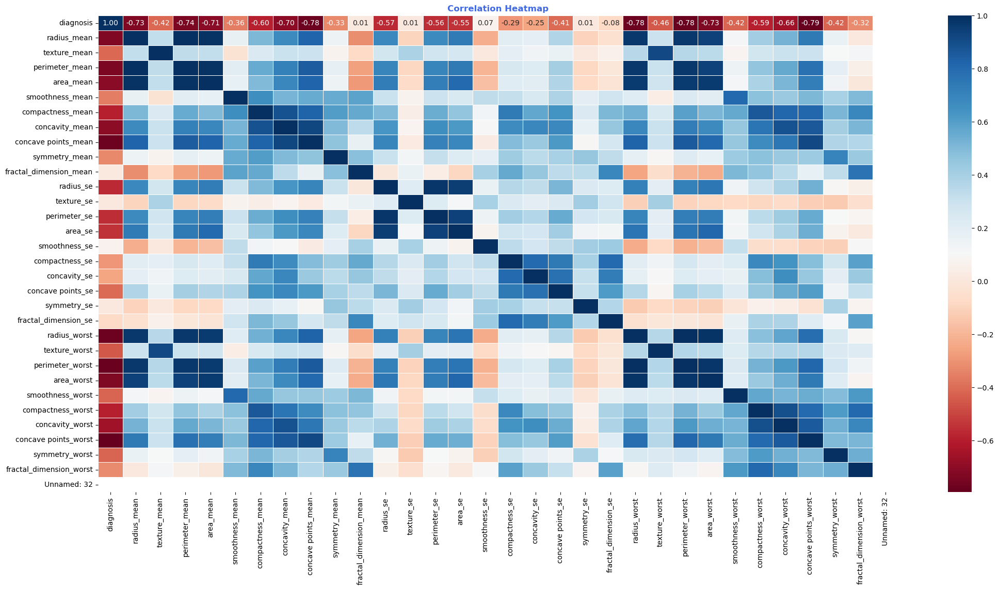

In [118]:

from sklearn.preprocessing import LabelEncoder

# Assuming 'y_true' contains categorical labels 'B' (Benign) and 'M' (Malignant)
label_encoder = LabelEncoder()
df['diagnosis'] = label_encoder.fit_transform(df['diagnosis'])
corr_matrix = df.corr()

plt.figure(figsize=(25, 12))
sns.heatmap(corr_matrix, annot=True, cmap='RdBu', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap',color='royalblue',weight='bold')
plt.show()